In [10]:
!pip install ultralytics

In [11]:
pip install opencv-python

In [12]:
import os
import json
import argparse
from ultralytics import YOLO
import cv2

In [13]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [14]:
dataset_root = "/content/drive/MyDrive/glove and bare hand dataset"
os.listdir(dataset_root)

['hands', 'gloves']

In [15]:
import os
import random
import shutil

In [16]:
# STEP 1: Creating YOLO labels
# -------------------------------
class_map = {
    "gloves": 0,  # gloved_hand
    "hands": 1    # bare_hand
}

for folder, cls in class_map.items():
    folder_path = os.path.join(dataset_root, folder)
    for fname in os.listdir(folder_path):
        if not fname.lower().endswith(".jpg"):
            continue
        txt_path = os.path.splitext(os.path.join(folder_path, fname))[0] + ".txt"
        with open(txt_path, "w") as f:
            # YOLO format: class x_center y_center width height (normalized)
            f.write(f"{cls} 0.5 0.5 1.0 1.0\n")

print("[INFO] YOLO labels created for all images.")

# -------------------------------
# STEP 2: Gathering all images
# -------------------------------
img_paths = []
for folder in ["gloves", "hands"]:
    folder_path = os.path.join(dataset_root, folder)
    for f in os.listdir(folder_path):
        if f.lower().endswith(".jpg"):
            img_paths.append(os.path.join(folder_path, f))

random.shuffle(img_paths)
n = len(img_paths)
train_end = int(0.8 * n)
val_end = int(0.9 * n)

splits = {
    "train": img_paths[:train_end],
    "val": img_paths[train_end:val_end],
    "test": img_paths[val_end:]
}

# -------------------------------
# STEP 3: Coping images & labels into YOLOv8 structure
# -------------------------------
dest_root = "/content/yolov8_dataset"
for split, files in splits.items():
    img_out = os.path.join(dest_root, "images", split)
    lbl_out = os.path.join(dest_root, "labels", split)
    os.makedirs(img_out, exist_ok=True)
    os.makedirs(lbl_out, exist_ok=True)

    for img_path in files:
        fname = os.path.basename(img_path)
        shutil.copy(img_path, os.path.join(img_out, fname))
        txt_file = os.path.splitext(img_path)[0] + ".txt"
        if os.path.exists(txt_file):
            shutil.copy(txt_file, os.path.join(lbl_out, fname.replace(".jpg", ".txt")))
        else:
            open(os.path.join(lbl_out, fname.replace(".jpg", ".txt")), "w").close()

print("[INFO] Dataset split complete: train/val/test")
print(f"[INFO] YOLOv8 dataset ready at '{dest_root}'")

[INFO] YOLO labels created for all images.
[INFO] Dataset split complete: train/val/test
[INFO] YOLOv8 dataset ready at '/content/yolov8_dataset'


In [17]:
import yaml

data = {
    'train': '/content/yolov8_dataset/images/train',
    'val': '/content/yolov8_dataset/images/val',
    'test': '/content/yolov8_dataset/images/test',
    'nc': 2,
    'names': ['gloved_hand','bare_hand']
}

with open('/content/yolov8_dataset/data.yaml', 'w') as f:
    yaml.dump(data, f)

print("data.yaml created!")

data.yaml created!


In [18]:
from ultralytics import YOLO

# Initializing model
model = YOLO('yolov8n.pt')  # pre-trained YOLOv8n

# Training on my dataset
model.train(
    data='/content/yolov8_dataset/data.yaml',
    epochs=5,            # we can increase later
    imgsz=640,            # image size
    batch=16,             # batch size
    project='/content/glove_detection',  # folder to save weights
    name='glove_v8',      # subfolder name
    exist_ok=True
)


Ultralytics 8.3.204 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/yolov8_dataset/data.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=5, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=glove_v8, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True

ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ff9755e10d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

In [28]:
import numpy as np

# Run validation
results = model.val()

# -------------------------
# 1️⃣ Overall metrics
# -------------------------
print("=== Overall Metrics ===")
print(f"mAP50-95: {results.box.map:.4f}")   # mean AP IoU 0.5:0.95
print(f"mAP50: {results.box.map50:.4f}")    # mean AP IoU 0.5
print(f"Precision: {results.box.mp:.4f}")   # mean precision
print(f"Recall: {results.box.mr:.4f}")      # mean recall
print(f"F1 score: {np.mean(results.box.f1):.4f}")  # mean F1 score
print("------------------------------\n")

# -------------------------
# 2️⃣ Per-class metrics
# -------------------------
print("=== Per-Class Metrics ===")
summary = results.summary()  # can be list of dicts

for cls in summary:
    # check if cls is dict
    if isinstance(cls, dict):
        class_name = cls.get('class', 'N/A')
        images = cls.get('images', 0)
        instances = cls.get('instances', 0)
        precision = cls.get('P', 0.0)
        recall = cls.get('R', 0.0)
        f1 = cls.get('F1', 0.0)
        map50 = cls.get('mAP50', 0.0)
        map50_95 = cls.get('mAP50-95', 0.0)
    else:  # fallback if list
        class_name = cls[0]
        images = cls[1]
        instances = cls[2]
        precision = cls[3]
        recall = cls[4]
        f1 = cls[5]
        map50 = cls[6]
        map50_95 = cls[7]

    print(f"Class: {class_name}")
    print(f"  Images: {images}, Instances: {instances}")
    print(f"  Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}")
    print(f"  mAP50: {map50:.4f}, mAP50-95: {map50_95:.4f}")
    print("------------------------------")


Ultralytics 8.3.204 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1016.0±494.0 MB/s, size: 782.6 KB)
val: Scanning /content/yolov8_dataset/labels/val.cache... 129 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 129/129 139.4Kit/s 0.0s
val: /content/yolov8_dataset/images/val/gloves_0000029.jpg: corrupt JPEG restored and saved
val: /content/yolov8_dataset/images/val/gloves_0000101.jpg: corrupt JPEG restored and saved
val: /content/yolov8_dataset/images/val/gloves_0000105.jpg: corrupt JPEG restored and saved
val: /content/yolov8_dataset/images/val/gloves_0000107.jpg: corrupt JPEG restored and saved
val: /content/yolov8_dataset/images/val/gloves_0000209.jpg: corrupt JPEG restored and saved
val: /content/yolov8_dataset/images/val/gloves_0000210.jpg: corrupt JPEG restored and saved
val: /content/yolov8_dataset/images/val/gloves_0000212.jpg: corrupt JPEG restored and saved
val: /content/yolov8_dataset/images/val/gloves_

In [29]:
import cv2
import json
import os
from ultralytics import YOLO

# Loading trained model
model = YOLO('/content/glove_detection/glove_v8/weights/best.pt')

# Input folders to process
input_folders = [
    '/content/drive/MyDrive/glove and bare hand dataset/gloves',
    '/content/drive/MyDrive/glove and bare hand dataset/hands'
]

output_root = '/content/detection_output'
log_root = '/content/logs'

# Creating output folders
os.makedirs(output_root, exist_ok=True)
os.makedirs(log_root, exist_ok=True)

for input_folder in input_folders:
    folder_name = os.path.basename(input_folder)  # 'gloves' or 'hands'

    # Creating subfolders for annotated images
    output_folder = os.path.join(output_root, folder_name)
    log_folder = os.path.join(log_root, folder_name)
    os.makedirs(output_folder, exist_ok=True)
    os.makedirs(log_folder, exist_ok=True)

    for img_name in os.listdir(input_folder):
        if not img_name.lower().endswith('.jpg'):
            continue

        img_path = os.path.join(input_folder, img_name)
        results = model(img_path)[0]

        # Annotating and saving image
        annotated_img = results.plot()
        cv2.imwrite(os.path.join(output_folder, img_name), annotated_img)

        # Saving JSON log
        detections = []
        for r in results.boxes.data.tolist():
            x1, y1, x2, y2, conf, cls = r
            detections.append({
                'label': model.names[int(cls)],
                'confidence': float(conf),
                'bbox': [int(x1), int(y1), int(x2), int(y2)]
            })

        log = {'filename': img_name, 'detections': detections}
        with open(os.path.join(log_folder, img_name.replace('.jpg','.json')), 'w') as f:
            json.dump(log, f, indent=2)

print("Detection completed for both gloves and bare hands!")



image 1/1 /content/drive/MyDrive/glove and bare hand dataset/gloves/gloves_0000001.jpg: 640x480 1 gloved_hand, 203.8ms
Speed: 5.0ms preprocess, 203.8ms inference, 9.9ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/drive/MyDrive/glove and bare hand dataset/gloves/gloves_0000002.jpg: 640x480 1 gloved_hand, 189.1ms
Speed: 4.1ms preprocess, 189.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/drive/MyDrive/glove and bare hand dataset/gloves/gloves_0000003.jpg: 640x480 1 gloved_hand, 180.9ms
Speed: 4.2ms preprocess, 180.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 480)

image 1/1 /content/drive/MyDrive/glove and bare hand dataset/gloves/gloves_0000018.jpg: 480x640 1 gloved_hand, 212.8ms
Speed: 5.3ms preprocess, 212.8ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)

image 1/1 /content/drive/MyDrive/glove and bare hand dataset/gloves/gloves_0000007.jpg: 640x480 1 gloved_hand, 282.6ms
Speed: 5

In [30]:
!pip install ultralytics opencv-python


In [31]:
script_content = """
import os
import cv2
import json
import argparse
from ultralytics import YOLO
from concurrent.futures import ThreadPoolExecutor

def process_image(model, img_path, output_folder, log_folder, conf_thresh):
    img_name = os.path.basename(img_path)
    results = model(img_path, conf=conf_thresh)[0]

    annotated_img = results.plot()
    cv2.imwrite(os.path.join(output_folder, img_name), annotated_img)

    detections = []
    for r in results.boxes.data.tolist():
        x1, y1, x2, y2, conf, cls = r
        detections.append({
            'label': model.names[int(cls)],
            'confidence': float(conf),
            'bbox': [int(x1), int(y1), int(x2), int(y2)]
        })

    log = {'filename': img_name, 'detections': detections}
    with open(os.path.join(log_folder, img_name.replace('.jpg', '.json')), 'w') as f:
        json.dump(log, f, indent=2)

def main(args):
    model = YOLO(args.weights)
    os.makedirs(args.output, exist_ok=True)
    os.makedirs(args.logs, exist_ok=True)

    img_paths = [os.path.join(args.input, f) for f in os.listdir(args.input) if f.lower().endswith(".jpg")]

    from concurrent.futures import ThreadPoolExecutor
    with ThreadPoolExecutor(max_workers=args.workers) as executor:
        for img_path in img_paths:
            executor.submit(process_image, model, img_path, args.output, args.logs, args.confidence)

    print(f"[INFO] Detection complete! Annotated images in '{args.output}', JSON logs in '{args.logs}'")

if __name__ == "__main__":
    parser = argparse.ArgumentParser(description="Gloved vs Bare Hand Detection")
    parser.add_argument("--input", type=str, required=True)
    parser.add_argument("--output", type=str, default="output")
    parser.add_argument("--logs", type=str, default="logs")
    parser.add_argument("--weights", type=str, default="best.pt")
    parser.add_argument("--confidence", type=float, default=0.5)
    parser.add_argument("--workers", type=int, default=4)
    args = parser.parse_args()
    main(args)
"""

# Save the script as a .py file
with open("/content/detection_script.py", "w") as f:
    f.write(script_content)


In [32]:
!python3 /content/detection_script.py \
    --input "/content/drive/MyDrive/glove and bare hand dataset" \
    --output "/content/detection_output" \
    --logs "/content/logs" \
    --weights "/content/glove_detection/glove_v8/weights/best.pt" \
    --confidence 0.5 \
    --workers 4


[INFO] Detection complete! Annotated images in '/content/detection_output', JSON logs in '/content/logs'


Showing image from gloves


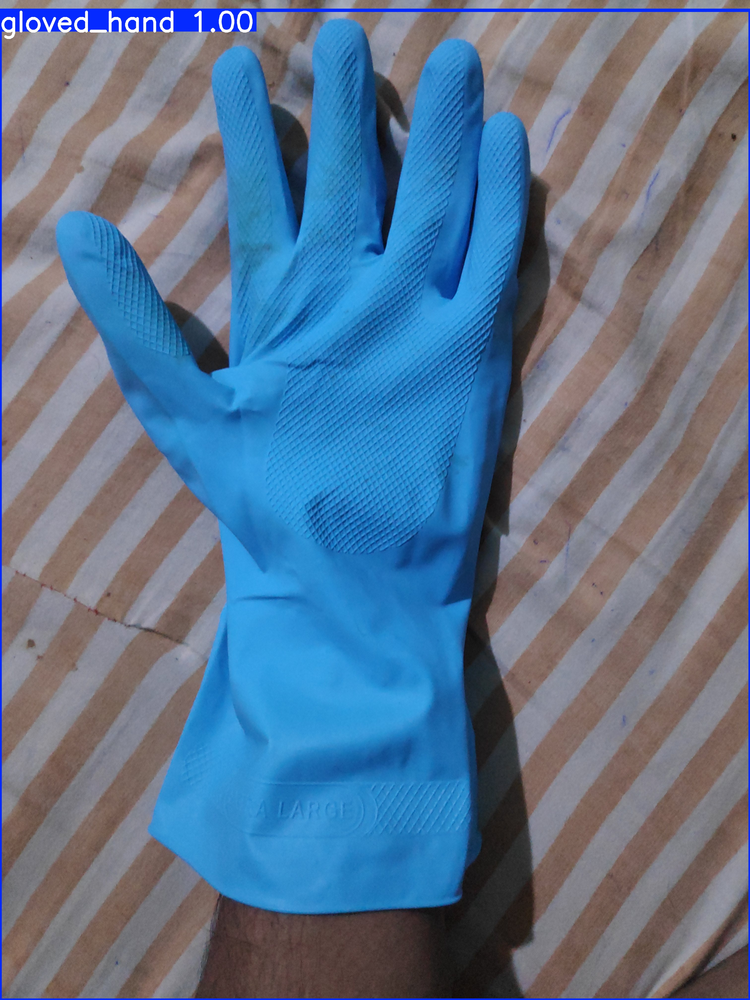

Showing image from hands


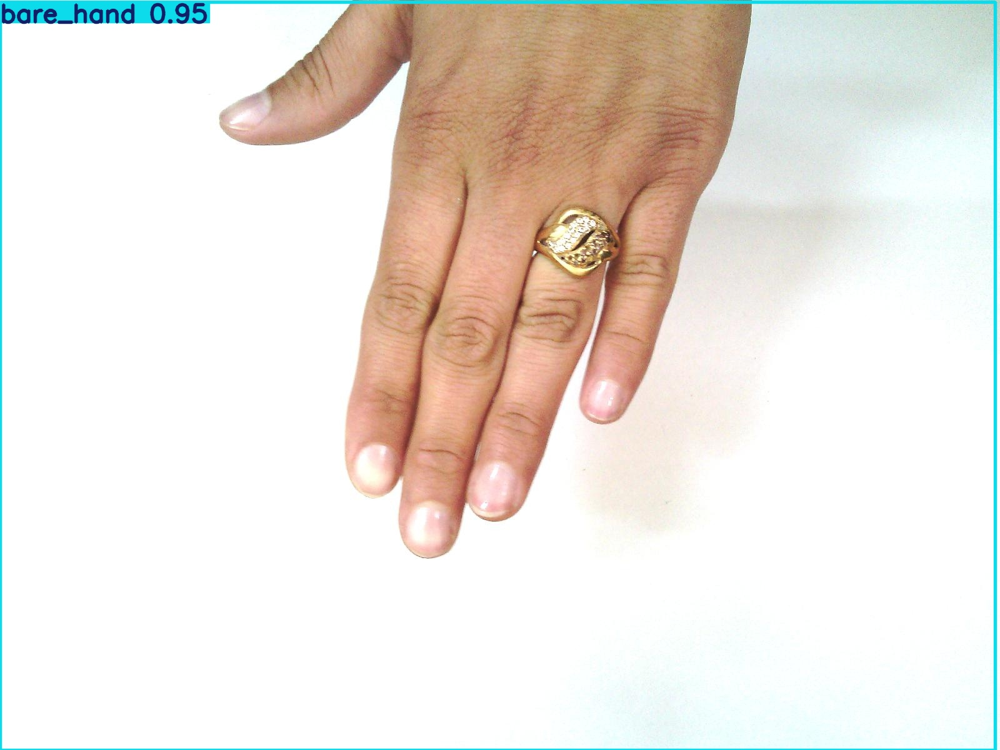

In [33]:
from google.colab.patches import cv2_imshow
import cv2
import os

output_root = "/content/detection_output"
for class_folder in os.listdir(output_root):
    class_path = os.path.join(output_root, class_folder)
    if not os.path.isdir(class_path):
        continue
    # Get first image in this class folder
    image_files = [f for f in os.listdir(class_path) if f.lower().endswith((".jpg", ".png", ".jpeg"))]
    if len(image_files) == 0:
        print(f"No images found in {class_folder}")
        continue
    sample_img_path = os.path.join(class_path, image_files[0])
    img = cv2.imread(sample_img_path)
    if img is not None:
        print(f"Showing image from {class_folder}")
        cv2_imshow(img)
    else:
        print(f"Failed to read {sample_img_path}")


In [34]:
import os
import json

log_root = "/content/logs"

for class_folder in os.listdir(log_root):
    class_path = os.path.join(log_root, class_folder)
    if not os.path.isdir(class_path):
        continue
    # Get first JSON file in this class folder
    json_files = [f for f in os.listdir(class_path) if f.lower().endswith(".json")]
    if len(json_files) == 0:
        print(f"No JSON files found in {class_folder}")
        continue
    sample_json_path = os.path.join(class_path, json_files[0])
    with open(sample_json_path, "r") as f:
        data = json.load(f)
    print(f"JSON log from {class_folder}:")
    print(json.dumps(data, indent=2))
    print("\n" + "="*50 + "\n")


JSON log from gloves:
{
  "filename": "gloves_0000112.jpg",
  "detections": [
    {
      "label": "gloved_hand",
      "confidence": 0.9968174695968628,
      "bbox": [
        0,
        20,
        2447,
        3264
      ]
    }
  ]
}


JSON log from hands:
{
  "filename": "hands_0000392.jpg",
  "detections": [
    {
      "label": "bare_hand",
      "confidence": 0.9631096720695496,
      "bbox": [
        0,
        2,
        1591,
        1200
      ]
    }
  ]
}




In [35]:
import shutil
from google.colab import files

# Zip logs folder
shutil.make_archive("/content/logs", 'zip', "/content/logs")
files.download("/content/logs.zip")

# Zip detection_output folder
shutil.make_archive("/content/detection_output", 'zip', "/content/detection_output")
files.download("/content/detection_output.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>